## plan:

- find existing dataset loader or implement own
  
- explore dataset
    - num images, num masks, num samples per instance, skin tone distribution, mean/std, area distribution (lesion/img_area ratio)
    - is it necessary to exclude tiny masks?
    - image hist equalization?
    - visualize more images from dataset
    - split dataset to train, val, test

- choose architecture to train

- train on small subset

- compute theoretical maximum of metrics in cosideration of upscaling

- choose lr

- train on bigger subset

- train on whole train set

- analyze hard cases

- augmentations

- tune parameters on val subset

- add postprocessing mask closing step

- dice loss

- weights & biases

metadata: https://www.kaggle.com/datasets/kmader/skin-cancer-mnist-ham10000/data?select=HAM10000_metadata.csv

images & masks: https://www.kaggle.com/datasets/surajghuwalewala/ham1000-segmentation-and-classification/data

In [1]:
import pandas as pd

metadata = pd.read_csv('ham10000/HAM10000_metadata.csv')

metadata

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear
...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face


## Let's see how many lesion instances have more than one sample

<Axes: ylabel='Frequency'>

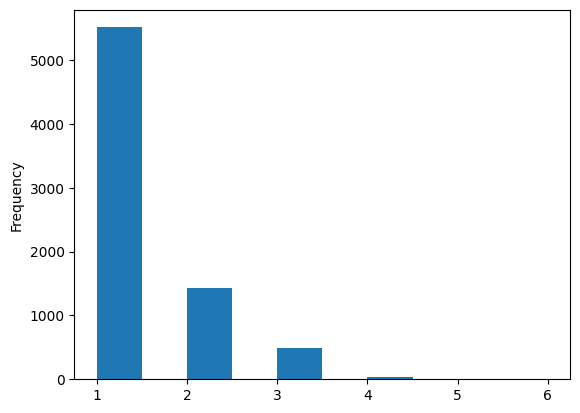

In [2]:
num_samples_per_lesion = metadata.groupby('lesion_id').size()
num_samples_per_lesion.plot.hist()

## Noticable portion of the instances has more than one image. We need to prevent a data leakage when splitting the dataset to train,val,test

## Let's implement the dataset class for our data

In [2]:
import torch
from torch.utils.data import Dataset
from torchvision.io import read_image, ImageReadMode
from pathlib import Path

class ImageMaskDataset(Dataset):
    def __init__(self, img_filenames, img_dir, mask_dir, mask_suffix='_segmentation', mask_ext='png', transform=None, target_transform=None):
        self.img_filenames = img_filenames
        self.img_dir = Path(img_dir)
        self.mask_dir = Path(mask_dir)
        self.mask_suffix = mask_suffix
        self.mask_ext = mask_ext
        
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.img_filenames)

    def __getitem__(self, idx):
        img_path = self.img_dir / self.img_filenames[idx]
        mask_path = self.mask_dir / (img_path.stem + self.mask_suffix + f'.{self.mask_ext}')
        
        image, mask = [read_image(str(p), ImageReadMode.RGB) for p in (img_path, mask_path)]

        mask = mask[0]
        mask[mask != 0] = 1
        
        if self.transform:
            result = self.transform(images=image, segmentation_maps=mask, return_tensors="pt")
        else:
            result = (image, mask)
            
        return result

## And create an instance of the dataset with all the images to compute some statistics

In [3]:
import os

dataset_path = Path('ham10000')

images_path = dataset_path / 'images'

masks_path = dataset_path / 'masks'

all_imgs = [i_p for i_p in os.listdir(images_path) if i_p.endswith('.jpg')]

dataset = ImageMaskDataset(all_imgs, images_path, masks_path)

## Let's implement the samples visualization function and see what data we have

In [14]:
%matplotlib inline

import matplotlib.pyplot as plt
import numpy as np

def plot_samples(img_mask_pairs: list[tuple[np.ndarray, np.ndarray]], samples_titles):
    fig, axes = plt.subplots(len(img_mask_pairs), 2, constrained_layout=True)

    fig.set_figheight(5*len(img_mask_pairs))
    fig.set_figwidth(10)

    for i, (img, mask) in enumerate(img_mask_pairs):
        axes[i, 0].imshow(img.permute(1,2,0))
        axes[i, 1].imshow(mask.squeeze()*255, cmap='gray', vmin=0, vmax=255)

        if len(samples_titles) != 0:
            axes[i, 0].set_title(samples_titles[i])

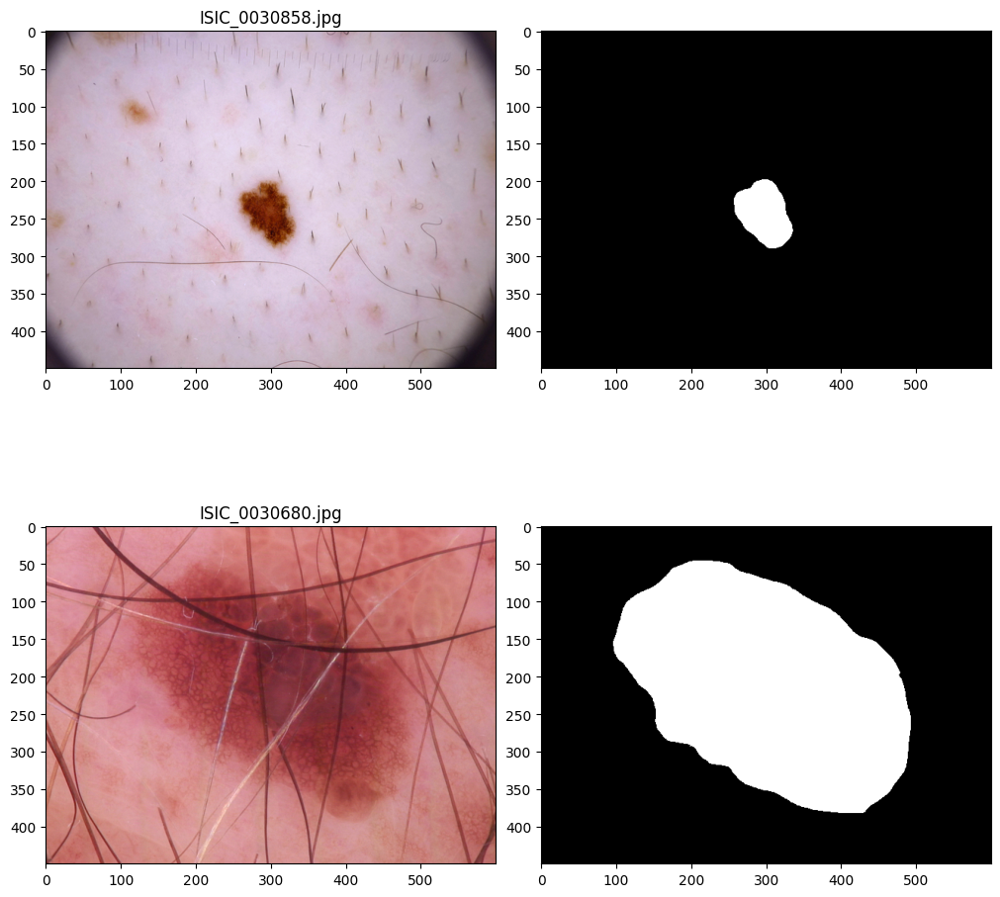

In [7]:
plot_samples([dataset[0], dataset[1]], [all_imgs[0], all_imgs[1]])

## Seems like some samples have a vignetting, so it could be important later on

## For now, let's create a mask to not taking into account these vignetted corners

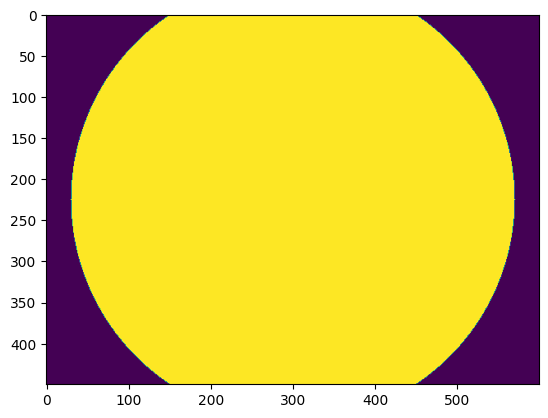

In [9]:
import cv2
import numpy as np

image = dataset[0][0]

round_center_mask = np.zeros(image.shape[1:], np.uint8)

diameter = np.max(round_center_mask.shape) * 0.9

round_center_mask = cv2.circle(round_center_mask, np.asarray(round_center_mask.shape[::-1], np.int32)//2, int(diameter/2), 255, -1)

plt.imshow(round_center_mask)

## Now, let's see the skin tone distribution. For this, let's convert RGB to HSL and take a median hue value from a skin parts of the image

In [10]:
# from https://github.com/limacv/RGB_HSV_HSL/blob/master/color_torch.py

def rgb2hsl_torch(rgb: torch.Tensor) -> torch.Tensor:
    cmax, cmax_idx = torch.max(rgb, dim=1, keepdim=True)
    cmin = torch.min(rgb, dim=1, keepdim=True)[0]
    delta = cmax - cmin
    hsl_h = torch.empty_like(rgb[:, 0:1, :, :])
    
    cmax_idx[delta == 0] = 3
    hsl_h[cmax_idx == 0] = (((rgb[:, 1:2] - rgb[:, 2:3]) / delta) % 6)[cmax_idx == 0]
    hsl_h[cmax_idx == 1] = (((rgb[:, 2:3] - rgb[:, 0:1]) / delta) + 2)[cmax_idx == 1]
    hsl_h[cmax_idx == 2] = (((rgb[:, 0:1] - rgb[:, 1:2]) / delta) + 4)[cmax_idx == 2]
    hsl_h[cmax_idx == 3] = 0.
    hsl_h /= 6.

    hsl_l = (cmax + cmin) / 2.
    hsl_s = torch.empty_like(hsl_h)
    hsl_s[hsl_l == 0] = 0
    hsl_s[hsl_l == 1] = 0
    hsl_l_ma = torch.bitwise_and(hsl_l > 0, hsl_l < 1)
    hsl_l_s0_5 = torch.bitwise_and(hsl_l_ma, hsl_l <= 0.5)
    hsl_l_l0_5 = torch.bitwise_and(hsl_l_ma, hsl_l > 0.5)
    hsl_s[hsl_l_s0_5] = ((cmax - cmin) / (hsl_l * 2.))[hsl_l_s0_5]
    hsl_s[hsl_l_l0_5] = ((cmax - cmin) / (- hsl_l * 2. + 2.))[hsl_l_l0_5]
    return torch.cat([hsl_h, hsl_s, hsl_l], dim=1)

In [12]:
from torch.utils.data import DataLoader
from tqdm import tqdm

dataloader = DataLoader(dataset, batch_size=64)

skin_hue_values = []

with torch.no_grad():
    round_center_mask_t = torch.tensor(round_center_mask).to(torch.bool)
    
    for imgs, masks in tqdm(dataloader):
        skin_masks = torch.logical_not(masks.to(torch.bool))
    
        skin_masks = skin_masks & round_center_mask_t
    
        hue_channel_imgs = rgb2hsl_torch(imgs / 255)[:, 0].unsqueeze(1)

        skin_hue = torch.where(skin_masks, hue_channel_imgs, torch.nan)

        median_hue = torch.nanmedian(skin_hue.view(skin_hue.shape[0], -1), dim=1)

        skin_hue_values.extend(median_hue.values.tolist())

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [04:32<00:00,  1.74s/it]


### Let's use sin() to take into account periodicity of the hue values

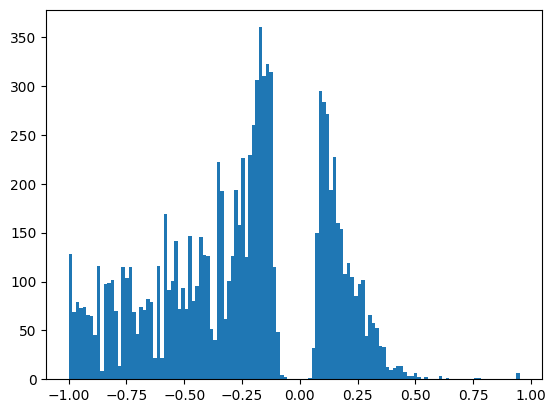

In [13]:
_ = plt.hist(list(np.sin(np.asarray(skin_hue_values) * 2 * np.pi)), bins=128)

## As we can see, the skin tone distribution isn't uniform. It's not as much darker skin tones in the dataset as lighter ones. This is important, when we need to deploy the model, since it isn't going to perform as good for other skin tones

## Now, let's see what are the mask sizes

In [15]:
from torch.utils.data import DataLoader
from tqdm import tqdm

def compute_samples_areas(dataset):
    dataloader = DataLoader(dataset, batch_size=64)
    
    areas = []
    
    with torch.no_grad():
        for _, masks in tqdm(dataloader):
            masks_areas = masks.squeeze().to(torch.bool).view(masks.shape[0], -1).sum(dim=1)
    
            areas.extend(masks_areas.tolist())
    
    return areas

areas = compute_samples_areas(dataset)

image = dataset[0][0]
image_hw = image.shape[1:]

metadata['area_ratio'] = np.asarray(areas) / np.prod(image_hw)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [00:38<00:00,  4.03it/s]


<Axes: >

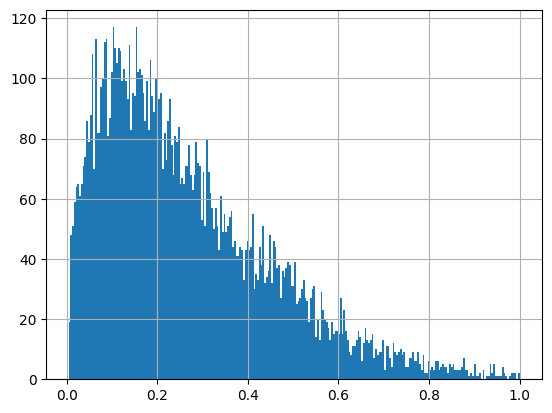

In [16]:
metadata['area_ratio'].hist(bins=256)

## Most of the masks aren't big. Let's examine some corner cases of the mask sizes

In [19]:
print(f'Num of samples with no true labels: {np.sum(areas == 0)}')

Num of samples with no true labels: 0


In [20]:
print(f'Num of samples with all true labels: {np.sum(areas == np.prod(image_hw))}')

Num of samples with all true labels: 2


In [21]:
print(f'Num of samples with 99% or more of true labels: {np.sum(areas > 0.99*np.prod(image_hw))}')

Num of samples with 99% or more of true labels: 3


In [22]:
img_area = np.prod(image_hw)

probs = np.arange(0.1, 1., 0.1)
quantiles = np.quantile(np.asarray(areas) / img_area, probs)

for p, q in zip(probs, quantiles):
    print(f'{p:.3f} -- {q:.3f}')

0.100 -- 0.062
0.200 -- 0.102
0.300 -- 0.139
0.400 -- 0.179
0.500 -- 0.222
0.600 -- 0.274
0.700 -- 0.336
0.800 -- 0.421
0.900 -- 0.532


## So, 50% of the masks have areas smaller than the 22% of image area

## Another thing to consider is a receptive field of the model. If the model's output has a size of (34, 46), then 1 pixel of the segmentation map covers 13x13 pixels of the input image. Assuming the lesion is closer to the circle, lte's estimate the minimal area of the mask our model would be able to segment

In [26]:
zoom_factors = np.asarray(model_out_spatial_size) / image_hw

receptive_field = 1/zoom_factors.min()

min_area_threshold = np.pi*13**2 / 4 / np.prod(gt_masks.shape[-2:])

print(f'Receptive field of one segmented pixel: {receptive_field}')
print(f'Minimal area of mask to include in dataset: {min_area_threshold}')

Receptive field of one segmented pixel: 13.235294117647058
Minimal area of mask to include in dataset: 0.0004916010726450695


In [27]:
print(f'Num of samples with size of mask lower than the receptive field: {np.sum(areas <= min_area_threshold)}')

Num of samples with size of mask lower than the receptive field: 0


## So, there's no samples with mask smaller than the receptive field size

## Now, let's explore the mask areas quantiles by visualizing them

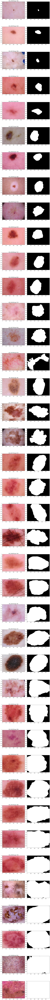

In [23]:
img_area = np.prod(image_hw)

indices_to_vis = []

areas_nparray = np.asarray(areas)

for q in np.arange(0.1, 1.1, 0.1):
    indices = np.argwhere(np.logical_and(areas_nparray >= (q - 0.1)*img_area, areas_nparray <= q*img_area)).squeeze()
    
    indices_to_vis.append(indices[np.argmin(areas_nparray[indices])])
    indices_to_vis.extend(np.random.choice(indices, 2).tolist())
    indices_to_vis.append(indices[np.argmax(areas_nparray[indices])])

plot_samples([dataset[i] for i in indices_to_vis], [all_imgs[i] + f': {i}' for i in indices_to_vis])

## Clearly, the mask is not always correct. This is important to note

## Next step is to prepare everything for the training of the model. First, start with metrics. For these, let's use Jaccard and dice scores

In [3]:
import transformers
import numpy as np
from scipy import ndimage

def one_hot_encoding(labels: np.ndarray, num_classes: int):
    one_hot = np.eye(num_classes)[labels]

    return one_hot
    

def compute_metrics(prediction: transformers.EvalPrediction, return_mean=True):
    batch_size = prediction.predictions.shape[0]
    num_classes = prediction.predictions.shape[1]
    gt_one_hot = one_hot_encoding(prediction.label_ids, num_classes)

    pred_labels = prediction.predictions.argmax(1)
    
    if prediction.label_ids.shape != pred_labels.shape:
        zoom_factors = np.asarray(prediction.label_ids.shape) / pred_labels.shape
        pred_labels = ndimage.zoom(pred_labels, zoom_factors, mode='nearest', order=0)

    pred_one_hot = one_hot_encoding(pred_labels, num_classes)

    gt_one_hot = gt_one_hot.reshape(batch_size, -1, num_classes)
    pred_one_hot = pred_one_hot.reshape(batch_size, -1, num_classes)
    
    intersection = np.sum(gt_one_hot * pred_one_hot, axis=1)
    union = np.sum(gt_one_hot, axis=1) + np.sum(pred_one_hot, axis=1) - intersection

    union[union == 0] = 1 # to avoid dividing by zero; this doesn't change the result, because then all positive samples is zero, true positive is also zero
    
    jaccard = intersection / union

    total_positive = np.sum(gt_one_hot, axis=1) + np.sum(pred_one_hot, axis=1)

    total_positive[total_positive == 0] = 1 # if there are samples with all true or false gt labels
    
    dice = 2 * intersection / total_positive

    metrics = {'jaccard': jaccard, 'dice': dice}

    if return_mean:
        metrics = {k: v.mean() for k,v in metrics.items()}
    
    return metrics

## For the influence of receptive field, our metrics can't be equal to 1.0. The more the downscaling, the less precise the mask

## Let's compute the theoretical maximal values of our metric

In [25]:
from torch.utils.data import DataLoader
from scipy import ndimage
from collections import defaultdict

from tqdm import tqdm

dataloader = DataLoader(dataset, batch_size=64)

model_out_spatial_size = (34, 46)

metrics = defaultdict(list)

with torch.no_grad():
    for i, (_, gt_masks) in enumerate(tqdm(dataloader)):
        gt_masks = gt_masks.squeeze(1)
        
        zoom_factors = np.asarray(tuple(gt_masks.shape[:1]) + model_out_spatial_size) / gt_masks.shape
        downsampled_gt_masks = ndimage.zoom(gt_masks, zoom_factors, mode='nearest', order=0)
        
        downsampled_gt_masks = np.transpose(np.eye(2)[downsampled_gt_masks], [0, 3, 1, 2])
        
        m = compute_metrics(transformers.EvalPrediction(predictions=downsampled_gt_masks, label_ids=gt_masks))

        for m_name, val in m.items():
            metrics[m_name].append(val)

print('Theoretical maximum of metrics\n', [f'{k}: {np.mean(metrics[k])}' for k in metrics])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 157/157 [02:52<00:00,  1.10s/it]

Theoretical maximum of metrics
 ['jaccard: 0.9612151665572611', 'dice: 0.9799040218244035']


## Next important thing is dataset splitting. Let's have only unique instances of lesions in val and test, and put all the non-unique ones into the training

In [4]:
import random

def get_lesion_ids_single_sample(metadata_df: pd.DataFrame):
    ids = [k for k, samples_ids in metadata_df.groupby('lesion_id').groups.items() if len(samples_ids) == 1]

    return ids

def l_ids_to_img_ids(metadata_df: pd.DataFrame, lesion_ids: set):
    imgs_ids = metadata_df[metadata_df['lesion_id'].isin(lesion_ids)]['image_id'].tolist()

    return imgs_ids

def create_dataset(imgs_ids: list, images_path: str, masks_path: str):
    return ImageMaskDataset([i + '.jpg' for i in imgs_ids], images_path, masks_path)

def split_ham10k_dataset(metadata_df: pd.DataFrame, images_path: str, masks_path: str, shuffle=True, \
                         split_train_1_sample=0.6, split_val_1_sample=0.2):    
    lesion_ids_1_sample = get_lesion_ids_single_sample(metadata_df)

    if shuffle:
        random.shuffle(lesion_ids_1_sample)

    train_split_id, val_split_id = int(len(lesion_ids_1_sample) * split_train_1_sample), int(len(lesion_ids_1_sample) * split_val_1_sample)
    val_split_id += train_split_id
    
    train_l_ids, val_l_ids, test_l_ids = lesion_ids_1_sample[:train_split_id], \
                                         lesion_ids_1_sample[train_split_id:val_split_id], \
                                         lesion_ids_1_sample[val_split_id:]

    l_ids_more_1_sample = metadata_df.groupby('lesion_id').groups.keys() - set(lesion_ids_1_sample)

    train_l_ids.extend(l_ids_more_1_sample)

    train_d, val_d, test_d = [create_dataset(l_ids_to_img_ids(metadata_df, l), images_path, masks_path) for l in [train_l_ids, val_l_ids, test_l_ids]]
    
    return train_d, val_d, test_d


In [5]:
dataset_path = Path('ham10000')

images_path = dataset_path / 'images'

masks_path = dataset_path / 'masks'

train_d, val_d, test_d = split_ham10k_dataset(metadata, images_path, masks_path)

## We need a collate function to turn our batches of samples into a tensors

In [6]:
import torch

def collate_fn(batch):
    return {
        'pixel_values': torch.stack([x['pixel_values'][0] for x in batch]),
        'labels': torch.stack([x['labels'][0] for x in batch])
    }

## Let's choose the model. I personally wanted to try transformers-based model finetuning, but it should be small to get the results faster. My choice is MobileViTv2 for segmentation. There's a pre-trained model on hf hub. But for more pragmatic reasons, some conv-based model would be better

## Let's load the weights and reinitialize some of the layers for our number of classes

In [7]:
from transformers import AutoImageProcessor, MobileViTV2ForSemanticSegmentation

image_processor = AutoImageProcessor.from_pretrained("apple/mobilevitv2-1.0-voc-deeplabv3", do_center_crop=False, do_flip_channel_order=False)
model = MobileViTV2ForSemanticSegmentation.from_pretrained("apple/mobilevitv2-1.0-voc-deeplabv3", num_labels=2, ignore_mismatched_sizes=True)

/Users/aleksandrrybnikov/work/git/ArWallTracking/venv-3.11/lib/python3.11/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream t

In [8]:
from transformers import TrainingArguments

training_args = TrainingArguments(
  output_dir="./mobilevitv2_deeplabv3_tiny_dataset",
  per_device_train_batch_size=16,
  evaluation_strategy="steps",
  num_train_epochs=10,
  fp16=False,
  save_steps=100,
  eval_steps=1,
  logging_steps=1,
  learning_rate=2e-4,
  save_total_limit=2,
  remove_unused_columns=False,
  push_to_hub=False,
  report_to='tensorboard',
  load_best_model_at_end=True,
)

## And train on some small dataset to see if it's converging before invest more time to the training

In [9]:
from transformers import Trainer

train_d.transform = image_processor

small_train_d = torch.utils.data.Subset(train_d, list(range(16)))


trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=collate_fn,
    compute_metrics=compute_metrics,
    train_dataset=small_train_d,
    eval_dataset=small_train_d,
    # tokenizer=image_processor,
)

/Users/aleksandrrybnikov/work/git/ArWallTracking/venv-3.11/lib/python3.11/site-packages/accelerate/accelerator.py:432: FutureWarning: Passing the following arguments to `Accelerator` is deprecated and will be removed in version 1.0 of Accelerate: dict_keys(['dispatch_batches', 'split_batches', 'even_batches', 'use_seedable_sampler']). Please pass an `accelerate.DataLoaderConfiguration` instead: 
dataloader_config = DataLoaderConfiguration(dispatch_batches=None, split_batches=False, even_batches=True, use_seedable_sampler=True)
  warnings.warn(


In [10]:
train_results = trainer.train()

/Users/aleksandrrybnikov/work/git/ArWallTracking/venv-3.11/lib/python3.11/site-packages/torch/nn/functional.py:4756: UserWarning: The operator 'aten::im2col' is not currently supported on the MPS backend and will fall back to run on the CPU. This may have performance implications. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/aten/src/ATen/mps/MPSFallback.mm:13.)
  return torch._C._nn.im2col(input, _pair(kernel_size), _pair(dilation), _pair(padding), _pair(stride))


Step,Training Loss,Validation Loss,Jaccard,Dice
1,0.782200,0.707167,0.248080,0.332188
2,0.656300,0.680869,0.302266,0.392580
3,0.625300,0.665028,0.348502,0.443695
4,0.577800,0.645321,0.403859,0.498616
5,0.543400,0.622773,0.452104,0.549488
6,0.510700,0.599678,0.493406,0.594838
7,0.490200,0.578496,0.535855,0.640773
8,0.463300,0.560615,0.570961,0.675488
9,0.455300,0.545988,0.604488,0.707448
10,0.441400,0.534592,0.626335,0.726354


In [11]:
train_results = trainer.train()

Step,Training Loss,Validation Loss,Jaccard,Dice
1,0.444900,0.484504,0.670534,0.761710
2,0.389800,0.439081,0.701802,0.784744
3,0.366000,0.399154,0.728441,0.808583
4,0.346500,0.365696,0.752825,0.830473
5,0.321300,0.338872,0.770895,0.846117
6,0.296600,0.317697,0.788994,0.861264
7,0.279700,0.300952,0.806777,0.874876
8,0.269600,0.288101,0.815056,0.881170
9,0.260200,0.278876,0.826020,0.889333
10,0.252600,0.272863,0.832227,0.893845


## The model can overfit with small number of steps on small subset of data, which is a good sing meaning that the training is set up correctly. We can move forward. Let's put all the training elements into a single function

In [7]:
from transformers import TrainingArguments
from transformers import Trainer
from transformers import AutoImageProcessor, MobileViTV2ForSemanticSegmentation
from torch.utils.data import Dataset, Subset

def train_from_pretrained(lr, lr_scheduler_type, train_dataset, num_epochs, TrainerClass=Trainer, eval_dataset=None):
    training_args = TrainingArguments(
      output_dir="./mobilevitv2_deeplabv3",
      per_device_train_batch_size=8,
      evaluation_strategy="steps",
      num_train_epochs=num_epochs,
      fp16=False,
      save_steps=1000,
      eval_steps=1000,
      logging_steps=10,
      lr_scheduler_type=lr_scheduler_type,
      learning_rate=lr,
      save_total_limit=2,
      remove_unused_columns=False,
      push_to_hub=False,
      report_to='tensorboard',
      load_best_model_at_end=True,
      dataloader_pin_memory=False,
      dataloader_drop_last=True
    )
    
    image_processor = AutoImageProcessor.from_pretrained("apple/mobilevitv2-1.0-voc-deeplabv3", do_center_crop=False, do_flip_channel_order=False)
    model = MobileViTV2ForSemanticSegmentation.from_pretrained("apple/mobilevitv2-1.0-voc-deeplabv3", num_labels=2, ignore_mismatched_sizes=True)

    def apply_transform(dataset_obj):
        if hasattr(dataset_obj, 'dataset'):
            dataset_obj.dataset.transform = image_processor
        else:
            dataset_obj.transform = image_processor

    apply_transform(train_dataset)
    apply_transform(eval_dataset)
        
    trainer = TrainerClass(
        model=model,
        args=training_args,
        data_collator=collate_fn,
        compute_metrics=compute_metrics,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        # tokenizer=image_processor,
    )
    
    trainer.train()

    return model, image_processor, trainer

## And find the valid range for the learning rate by getting the smallest and the largest value

In [55]:
small_train_d = torch.utils.data.Subset(train_d, list(range(1000)))

In [56]:
train_from_scratch(1e-5, 'constant', small_train_d, num_epochs=0.2)

Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Step,Training Loss,Validation Loss


In [58]:
train_from_scratch(1e-4, 'constant', small_train_d, num_epochs=0.2)

Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/Users/aleksandrrybnikov/work/git/ArWallTracking/venv-3.11/lib/python3.11/site-packages/accelerate/accelerator.py:432: FutureWarning: Passing the following arguments to `Accelerator` is deprecated and will be removed in version 1.0 of Accelerate: dict_keys(['dispatch_batches', 'split_batches', 'even_batches', 'use_seedable_sampler']). Please pass an `accelerate.DataLoaderConfigurat

Step,Training Loss,Validation Loss


In [59]:
train_from_scratch(1e-2, 'constant', small_train_d, num_epochs=0.2)

Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Step,Training Loss,Validation Loss


In [60]:
train_from_scratch(1e-1, 'constant', small_train_d, num_epochs=0.2)

Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Step,Training Loss,Validation Loss


In [61]:
train_from_scratch(1, 'constant', small_train_d, num_epochs=0.2)

Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Step,Training Loss,Validation Loss


## These are the results

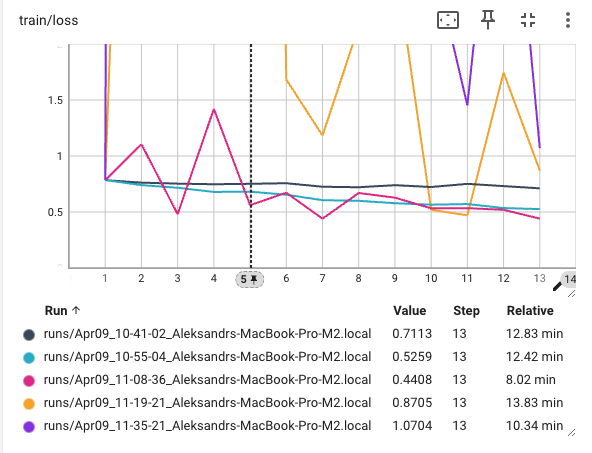

## For value of 1e-5 there is almost no convergence, for the value 1e-1 there's a convergenace but closer to explode. So the range for lr is [1e-4, 1e-1]

In [16]:
%load_ext tensorboard
%tensorboard --logdir ./mobilevitv2_deeplabv3

## To choose the lr value, let's implement a custom Trainer with the custom lr scheduler to explore the found valid range

In [57]:
from torch.optim.lr_scheduler import LambdaLR
from transformers import Trainer
import torch

class LRSelectTrainer(Trainer):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self._lr_factors_ = 10**np.linspace(0, 3, 100)

    def _compute_lr(self, epoch):
        lr = self._lr_factors_[int(epoch) % len(self._lr_factors_)]
        return lr
            
    def create_optimizer_and_scheduler(self, num_training_steps):
        self.create_optimizer()
        
        self.lr_scheduler = LambdaLR(self.optimizer, lambda epoch: self._compute_lr(epoch))
        self._created_lr_scheduler = True

In [55]:
train_d_16 = torch.utils.data.Subset(train_d, list(range(16)))

train_from_pretrained(1e-4, 'constant', train_d_16, 100, LRSelectTrainer)

Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/Users/aleksandrrybnikov/work/git/ArWallTracking/venv-3.11/lib/python3.11/site-packages/accelerate/accelerator.py:432: FutureWarning: Passing the following arguments to `Accelerator` is deprecated and will be removed in version 1.0 of Accelerate: dict_keys(['dispatch_batches', 'split_batches', 'even_batches', 'use_seedable_sampler']). Please pass an `accelerate.DataLoaderConfigurat

1.0
1.0
1.0722672220103233
1.0722672220103233


Step,Training Loss,Validation Loss


1.1497569953977358
1.1497569953977358
1.2328467394420661
1.2328467394420661
1.321941148466029
1.321941148466029
1.4174741629268053
1.4174741629268053
1.5199110829529336
1.5199110829529336
1.6297508346206442
1.6297508346206442
1.7475284000076838
1.7475284000076838
1.8738174228603839
1.8738174228603839
2.0092330025650473
2.0092330025650473
2.154434690031884
2.154434690031884
2.3101297000831598
2.3101297000831598
2.4770763559917106
2.4770763559917106
2.6560877829466865
2.6560877829466865
2.848035868435802
2.848035868435802
3.0538555088334154
3.0538555088334154
3.2745491628777286
3.2745491628777286
3.511191734215131
3.511191734215131
3.7649358067924683
3.7649358067924683
4.0370172585965545
4.0370172585965545
4.328761281083058
4.328761281083058
4.641588833612779
4.641588833612779
4.977023564332112
4.977023564332112
5.3366992312063095
5.3366992312063095
5.722367659350217
5.722367659350217
6.1359072734131725
6.1359072734131725
6.579332246575681
6.579332246575681
7.054802310718643
7.0548023107

IndexError: index 100 is out of bounds for axis 0 with size 100

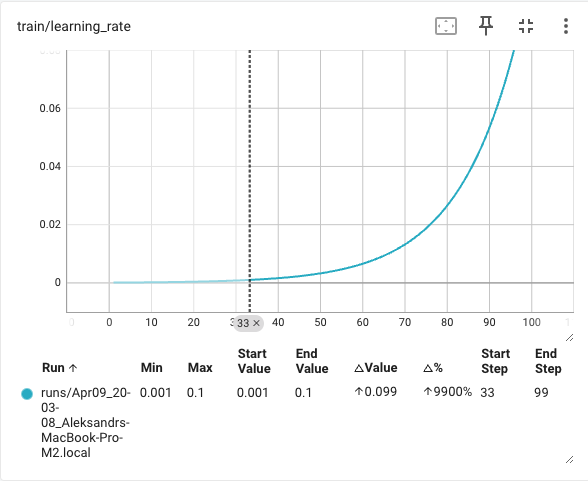
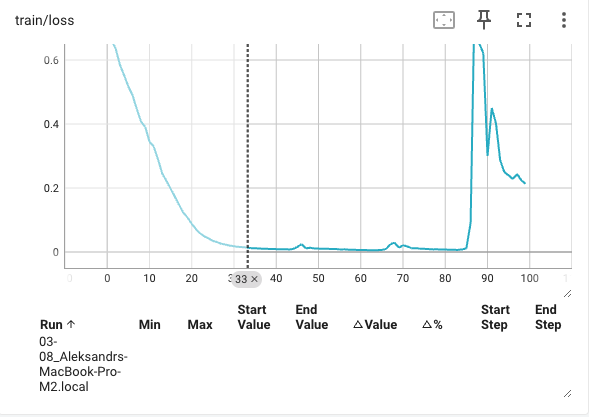

## Seems that the value of 1e-3 would be a good choice for the lr

## Let's try this value to see if it's working

In [75]:
train_d_1000 = torch.utils.data.Subset(train_d, list(range(1000)))
val_d_100 = torch.utils.data.Subset(val_d, list(range(100)))

model_td1000 = train_from_pretrained(1e-3, 'constant', train_d_1000, 10, eval_dataset=val_d_100)

Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/Users/aleksandrrybnikov/work/git/ArWallTracking/venv-3.11/lib/python3.11/site-packages/accelerate/accelerator.py:432: FutureWarning: Passing the following arguments to `Accelerator` is deprecated and will be removed in version 1.0 of Accelerate: dict_keys(['dispatch_batches', 'split_batches', 'even_batches', 'use_seedable_sampler']). Please pass an `accelerate.DataLoaderConfigurat

Step,Training Loss,Validation Loss,Jaccard,Dice
100,0.154400,0.198880,0.822672,0.894643
200,0.113400,0.219153,0.781695,0.866663
300,0.109300,0.198622,0.835316,0.902764
400,0.194700,0.206338,0.820220,0.892721
500,0.066100,0.178210,0.839085,0.905362
600,0.080600,0.166592,0.842474,0.908274
700,0.116200,0.177623,0.843571,0.908244
800,0.081200,0.200458,0.851703,0.912900
900,0.065200,0.222500,0.830414,0.898683
1000,0.227600,0.233568,0.828091,0.897345


## Let's predict the masks for the validation subset and visualize the cases with the lowest jaccard score

In [76]:
preds = model_td1000[2].predict(val_d_100)

In [89]:
val_metrics_per_sample = compute_metrics(preds, return_mean=False)

In [12]:
def visualize_hard_cases(computed_metrics, predictions, dataset, num_vis=10):
    indices = np.argsort(computed_metrics)[:num_vis]
    
    def pred_to_mask(p, shape_to_resize):
        labels = p.argmax(0)
        zoom_factors =  shape_to_resize / np.asarray(labels.shape)
        labels = ndimage.zoom(labels, zoom_factors, mode='nearest', order=0)
        return labels

    plot_samples([(dataset[i]['pixel_values'][0], np.hstack([pred_to_mask(predictions[i], 
                                                                       dataset[i]['labels'][0].shape), 
                                                          dataset[i]['labels'][0]])) for i in indices],
                [f'{computed_metrics[i]}' for i in indices])

[97 58 29 37 86 95 76 62 14 96]
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)


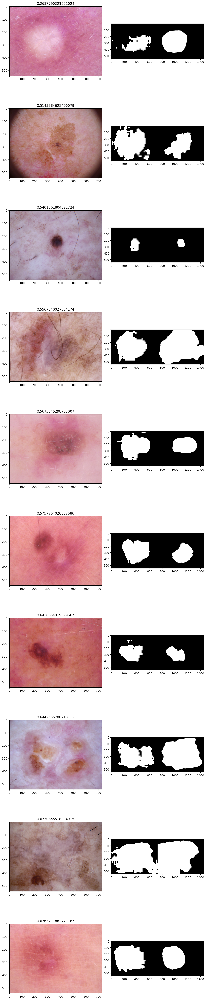

In [140]:
visualize_hard_cases(val_metrics_per_sample['jaccard'][..., 1], preds.predictions, val_d_100)

## Now, everything is ready to train the model on the whole train data

In [8]:
model_full_train_d = train_from_pretrained(1e-3, 'constant', train_d, 10, eval_dataset=val_d)

/Users/aleksandrrybnikov/work/git/ArWallTracking/venv-3.11/lib/python3.11/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
Some weights of MobileViTV2ForSemanticSegmentation were not initialized from the model checkpoint at apple/mobilevitv2-1.0-voc-deeplabv3 and are newly initialized because the shapes did not match:
- segmentation_head.classifier.convolution.weight: found shape torch.Size([21, 512, 1, 1]) in the checkpoint and torch.Size([2, 512, 1, 1]) in the model instantiated
- segmentation_head.classifier.convolution.bias: found shape torch.Size([21]) in the checkpoint and torch.Size([2]) in the model instantiated
You should probably TRAIN this model on a down-stream t

Step,Training Loss,Validation Loss,Jaccard,Dice
1000,0.086100,0.096159,0.901754,0.944128
2000,0.085600,0.083592,0.908301,0.948801
3000,0.076400,0.093639,0.899672,0.943813
4000,0.063900,0.077517,0.903933,0.946639
5000,0.063000,0.080108,0.903390,0.946077
6000,0.075900,0.076840,0.907686,0.948504
7000,0.065500,0.075525,0.913938,0.952407
8000,0.056600,0.074346,0.912752,0.951938
9000,0.062600,0.077409,0.908099,0.949222


In [9]:
preds_full_train = model_full_train_d[2].predict(val_d)

In [17]:
val_metrics_full_train_per_sample = compute_metrics(preds_full_train, return_mean=False)


[ 403  386 1095  931  148 1081  178 1079  100  151]
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)
(544, 725)


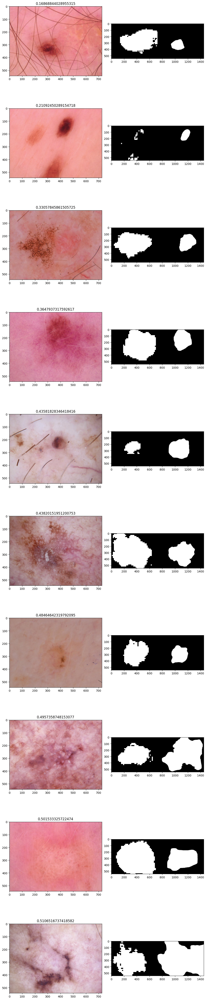

In [15]:
visualize_hard_cases(val_metrics_full_train_per_sample['jaccard'][..., 1], preds_full_train.predictions, val_d)

## Even though the results aren't ideal, the model does reasonble job, basically labelling the lesions correctly. The low scores aren't coming from the poor performance, but rather from the labelling incorrectness, as I can see with my non-professional eyes

In [56]:
!pip install accelerate --upgrade

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 290.1/290.1 kB 4.3 MB/s eta 0:00:003.0 MB/s eta 0:00:01
  Attempting uninstall: accelerate
    Found existing installation: accelerate 0.24.1
    Uninstalling accelerate-0.24.1:
      Successfully uninstalled accelerate-0.24.1
